# Trial phase characterization

In [1]:
""" 
IMPORTS
"""
import os
import autograd.numpy as np
import pickle
import seaborn as sns
from collections import defaultdict
import pandas as pd

# --Machine learning and statistics+
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer

from one.api import ONE
from jax import vmap
from pprint import pprint
import jax.numpy as jnp
import jax.random as jr
import matplotlib.pyplot as plt
from dynamax.hidden_markov_model import GaussianHMM

# Get my functions
functions_path =  '/home/ines/repositories/representation_learning_variability/Models/Sub-trial//2_fit_models/'
#functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability//Models/Sub-trial//2_fit_models/'
os.chdir(functions_path)
from fitting_functions import cross_validate_model
os.chdir(functions_path)
from plotting_functions import bins_per_trial_phase, plot_states_aligned, params_to_df, align_bin_design_matrix, states_per_trial_phase, plot_states_aligned_trial, traces_over_sates

one = ONE()


No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


## Parameters

In [2]:
bin_size = 0.1

var_names = ['avg_wheel_vel', 'pupil_diameter',
       'whisker_me', 'nose_speed_X', 'nose_speed_Y', 
       'l_paw_speed_X', 'l_paw_speed_Y', 'pupil_speed_X',
       'pupil_speed_Y', 'Gaussian_licks']

var_names = ['avg_wheel_vel', 'pupil_diameter',
       'whisker_me', 'nose_speed', 'l_paw_speed', 'left_X', 'left_Y',
       'pupil_speed', 'pupil_X', 'pupil_Y', 'Lick count']

num_states = 3

# Plotting params
bin_size = 0.1
multiplier = 1/bin_size

event_type_list = ['goCueTrigger_times']  # , 'feedback_times', 'firstMovement_times'
event_type_name = ['Go cue']  # , 'Feedback time', 'First movement onset'

### Get design matrices

In [3]:
data_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Design matrix/' + str(bin_size) + '/'
os.chdir(data_path)
design_matrices = os.listdir(data_path)

## Preprocess list of design matrices

In [4]:
# Save data of all sessions for latter
matrix_all = defaultdict(list)
matrix_all_unnorm = defaultdict(list)
session_all = defaultdict(list)

for m, mat in enumerate(design_matrices[0:1]):
    
    # Trials data
    session = design_matrices[m][14:-4]
    
    session = '2e6e179c-fccc-4e8f-9448-ce5b6858a183'
    mat = 'design_matrix_2e6e179c-fccc-4e8f-9448-ce5b6858a183_0.1new_version'
    
    session_trials = one.load_object(session, obj='trials', namespace='ibl')
    session_trials = session_trials.to_df()
    session_end = list(session_trials['stimOff_times'][-1:])[0]  # TODO: this might not work if stimOff times are missing
    session_start = list(session_trials['stimOn_times'])[0]
    
    big_design_matrix = pickle.load(open(mat, "rb"))
    
    design_matrix = big_design_matrix.groupby('Bin')[var_names].mean()  # 
    design_matrix = design_matrix.reset_index(level = [0])  # , 'Onset times'
    design_matrix = design_matrix.dropna()
    
    # Trim design matrix to be as long as the session (otherwise it will include task-unrelated behavior)
    design_matrix = design_matrix.loc[(design_matrix['Bin'] < session_end * 10) & (design_matrix['Bin'] > session_start * 10)]
    training_set = np.array(design_matrix[var_names]).copy() 
    
    if len(training_set) > 0:
      # Standardization using StandardScaler
      scaler = StandardScaler()
      standardized = scaler.fit_transform(training_set)
      # Normalize between 0 and 1
      normalizer = Normalizer().fit(standardized)
      normalized = normalizer.transform(standardized)
      
    # Save results
    matrix_all[mat].append(normalized)
    session_all[mat].append(session_trials)    
    matrix_all_unnorm[mat].append(design_matrix) 

## Trial phase

In [5]:
bins_df = bins_per_trial_phase(design_matrix, session_trials)
bins_df = bins_df.rename(columns={0: 'Bin'})
new_df = design_matrix.merge(bins_df, on='Bin')
melted = pd.melt(new_df, id_vars=['Bin', 'label', 'Trial'], value_vars=np.array(new_df.keys()[1:-1]))

/home/ines/repositories/representation_learning_variability/Models/Sub-trial/2_fit_models/plotting_functions.py:419: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_df = quiescence_df.append(left_stim_df)
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/2_fit_models/plotting_functions.py:420: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_df = all_df.append(right_stim_df)
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/2_fit_models/plotting_functions.py:421: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_df = all_df.append(left_df)
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/2_fit_models/plotting_functions.py:422: FutureWarning

<AxesSubplot: xlabel='label', ylabel='value'>

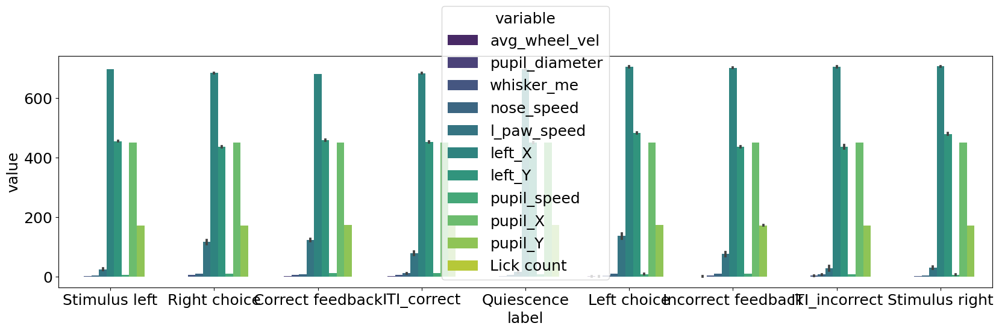

In [13]:
fig, ax = plt.subplots(figsize=[20, 5])
sns.barplot(hue='variable', y='value', x='label', data=melted, palette='viridis')
#plt.ylim([-5, 5])

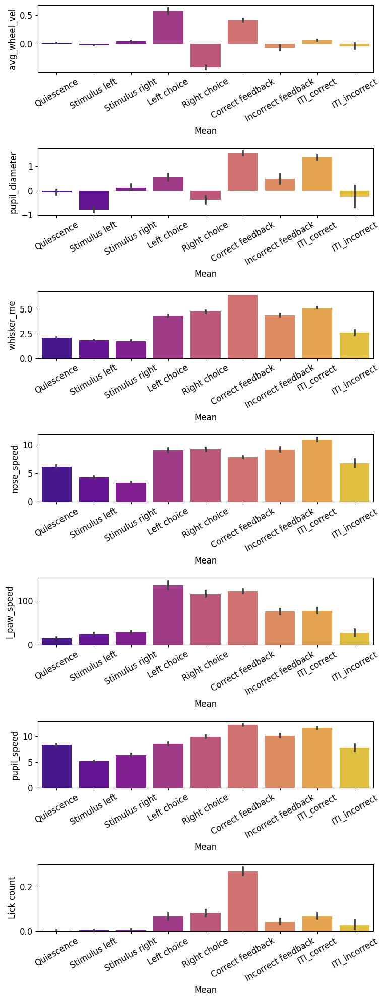

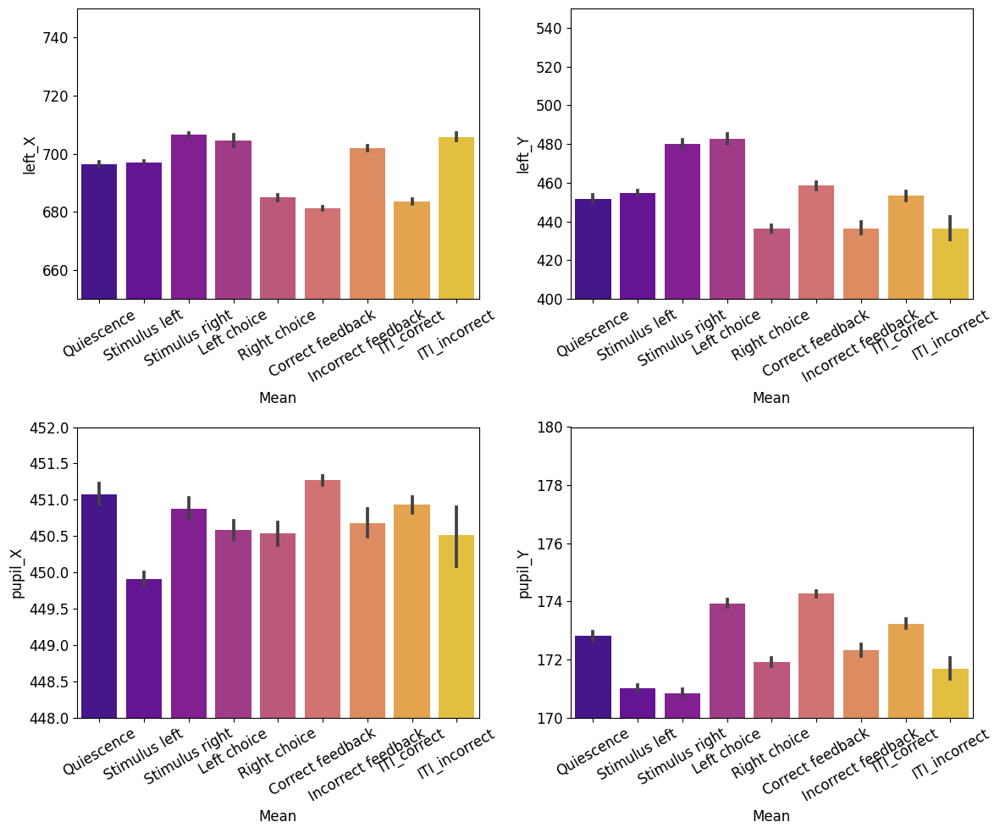

In [15]:
trial_epochs = new_df['label'].unique()

# Plot some variables
first_vars = ['avg_wheel_vel',
 'pupil_diameter',
 'whisker_me',
 'nose_speed',
 'l_paw_speed',
 'pupil_speed',
 'Lick count']

fig, ax = plt.subplots(nrows=len(first_vars) , ncols=1, sharex=False, sharey=False, figsize=[8, 20])
plt.rc('font', size=12)

for v, var in enumerate(first_vars):
    use_data = new_df[['Bin', 'label', var]]
    sns.barplot(y=var, x='label', data=use_data, ax=ax[v], palette='plasma', order = ['Quiescence', 'Stimulus left', 'Stimulus right', 
                                                                                      'Left choice', 'Right choice', 'Correct feedback', 
                                                                                      'Incorrect feedback', 'ITI_correct', 'ITI_incorrect'])
    ax[v].set_xlabel('Mean')
    ax[v].set_xticklabels(['Quiescence', 'Stimulus left', 'Stimulus right', 'Left choice', 'Right choice', 'Correct feedback', 
                                                                                      'Incorrect feedback', 'ITI_correct', 'ITI_incorrect'], rotation=30)

    #ax[v].set_ylim([np.min(use_data[var]), np.max(use_data[var])])
plt.tight_layout()
plt.show()

pos_vars = [ 'left_X',
 'left_Y',
 'pupil_X',
 'pupil_Y',]
fig, ax = plt.subplots(nrows=2 , ncols=2, sharex=False, sharey=False, figsize=[12, 10])
plt.rc('font', size=12)

for v, var in enumerate(pos_vars):
    
    use_data = new_df[['Bin', 'label', var]]

    if var == 'left_X':
        axis = ax[0, 0]
        ymin = 650
        ymax = 750
    elif var == 'left_Y':
        axis = ax[0, 1]
        ymin = 400
        ymax = 550
    elif var == 'pupil_X':
        axis = ax[1, 0]
        ymin = 448
        ymax = 452
    elif var == 'pupil_Y':
        axis = ax[1, 1]
        ymin = 170
        ymax = 180
        
    sns.barplot(y=var, x='label', data=use_data, ax=axis, palette='plasma', order = ['Quiescence', 'Stimulus left', 'Stimulus right', 
                                                                                    'Left choice', 'Right choice', 'Correct feedback', 
                                                                                    'Incorrect feedback', 'ITI_correct', 'ITI_incorrect'])
    axis.set_xlabel('Mean')
    axis.set_xticklabels(['Quiescence', 'Stimulus left', 'Stimulus right', 'Left choice', 'Right choice', 'Correct feedback', 
                                                                                    'Incorrect feedback', 'ITI_correct', 'ITI_incorrect'], rotation=30)

    axis.set_ylim([ymin, ymax])
    
plt.tight_layout()
plt.show()

## PCA on data samples

In [16]:
"""
PRINCIPLE COMPONENT ANALYSES
"""

X = matrix_all[mat][0] # (n_samples, n_features)
#X = np.array(design_matrix)

# Mean centered and equal variance (redundant code)
scaler = StandardScaler()
scaler.fit(X)

pca = PCA() # svd_solver='full'
#pca.fit(scaler.transform(X))
X_reduced = pca.fit_transform(scaler.transform(X))
#X_reduced = pca.fit_transform(X)


Text(0, 0.5, '% Variance explained')

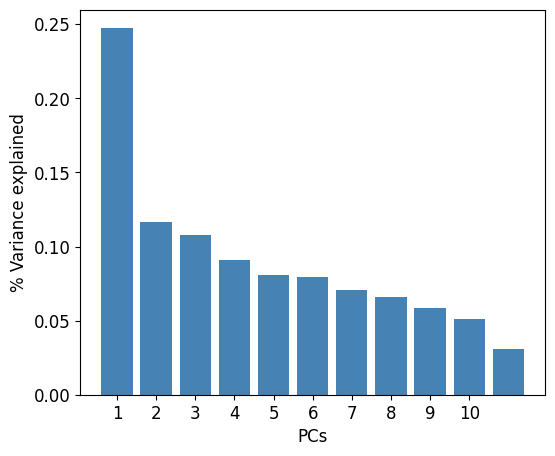

In [17]:
# Plot variance explained per principle component
fig, ax = plt.subplots(figsize=[6,5])
plt.rc('font', size=18)
keep_pc = np.shape(X)[1]
plt.bar(np.arange(1, keep_pc+1, 1), pca.explained_variance_ratio_[0:keep_pc], color='steelblue')
plt.xticks(np.arange(1, keep_pc, 1))
#plt.xlim([0, 3])
plt.xlabel('PCs')
plt.ylabel('% Variance explained')

### Get bin information

In [24]:
# Plot projections of datapoints into first 3 principal components
augmented_data = pd.DataFrame(columns=['Bin'], index=range(len(X_reduced)))
augmented_data['Bin'] = design_matrix['Bin']
augmented_data['pc1'] = X_reduced[:, 0].transpose()
augmented_data['pc2'] = X_reduced[:, 1].transpose()
augmented_data['pc3'] = X_reduced[:, 2].transpose()
augmented_data['pc4'] = X_reduced[:, 3].transpose()
augmented_data['pc5'] = X_reduced[:, 4].transpose()
augmented_data['pc6'] = X_reduced[:, 5].transpose()
augmented_data['pc7'] = X_reduced[:, 6].transpose()
augmented_data['pc8'] = X_reduced[:, 7].transpose()
augmented_data['pc9'] = X_reduced[:, 8].transpose()
augmented_data['pc10'] = X_reduced[:, 9].transpose()

In [25]:
augmented = augmented_data.merge(melted[['Bin', 'label', 'Trial']].drop_duplicates(), on='Bin')

augmented['broader_label'] = augmented['label']
augmented.loc[augmented['broader_label']=='Stimulus right', 'broader_label'] = 'Pre-choice'
augmented.loc[augmented['broader_label']=='Stimulus left', 'broader_label'] = 'Pre-choice'
augmented.loc[augmented['broader_label']=='Quiescence', 'broader_label'] = 'Pre-choice'
augmented.loc[augmented['broader_label']=='Left choice', 'broader_label'] = 'Choice'
augmented.loc[augmented['broader_label']=='Right choice', 'broader_label'] = 'Choice'
augmented.loc[augmented['broader_label']=='Correct feedback', 'broader_label'] = 'Post-choice'
augmented.loc[augmented['broader_label']=='Incorrect feedback', 'broader_label'] = 'Post-choice'
augmented.loc[augmented['broader_label']=='ITI_correct', 'broader_label'] = 'Post-choice'
augmented.loc[augmented['broader_label']=='ITI_incorrect', 'broader_label'] = 'Post-choice'

(0.0, 100.0)

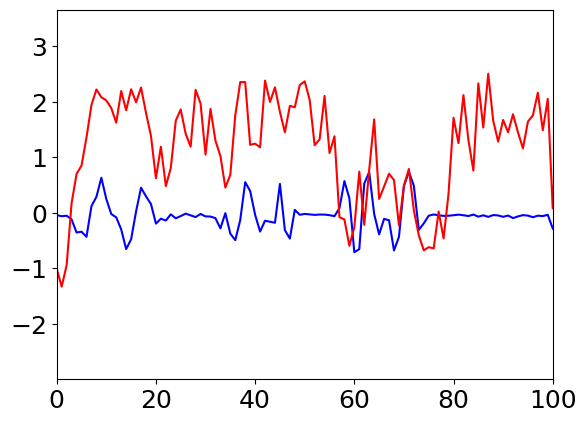

In [26]:
plt.plot(X[:, 0], color='blue')
plt.plot(augmented['pc1'], color='red')
plt.xlim([0, 100])


### Find trials

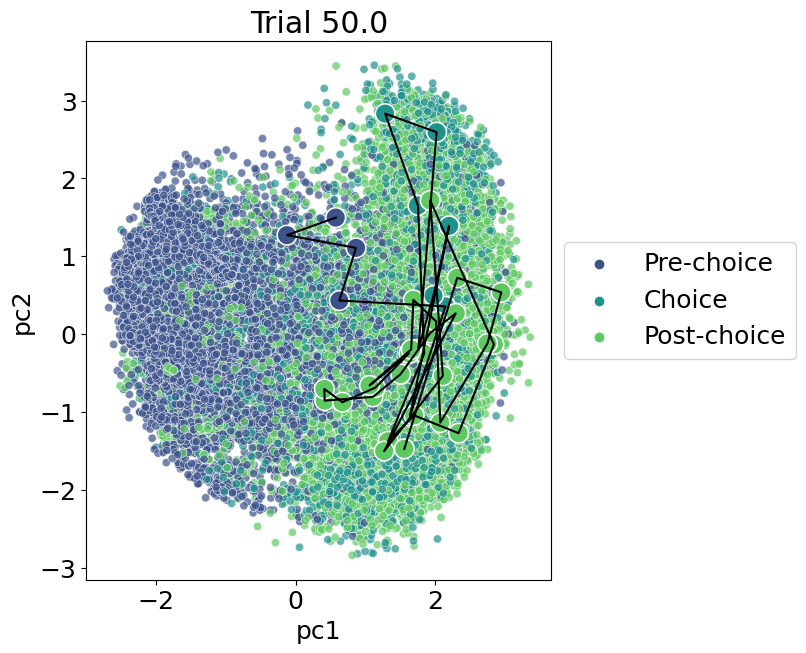

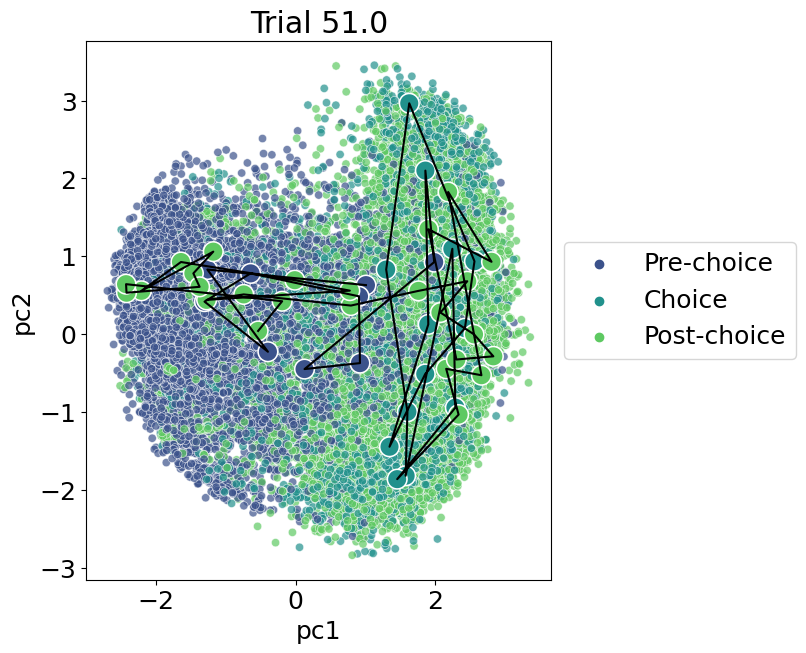

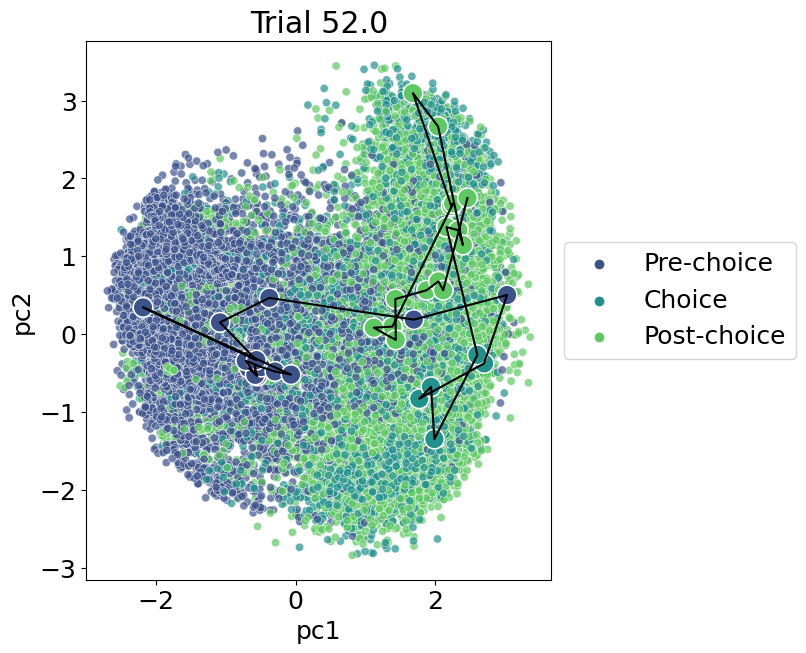

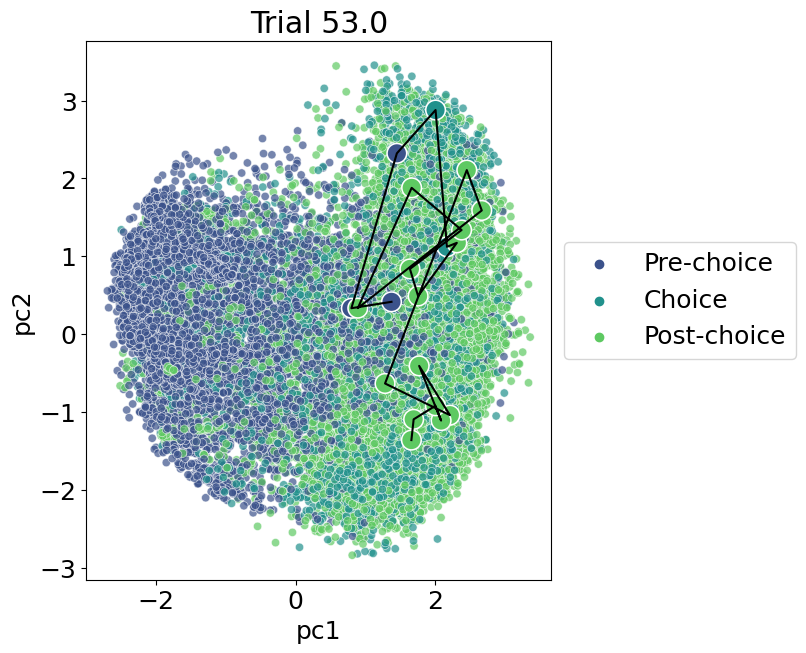

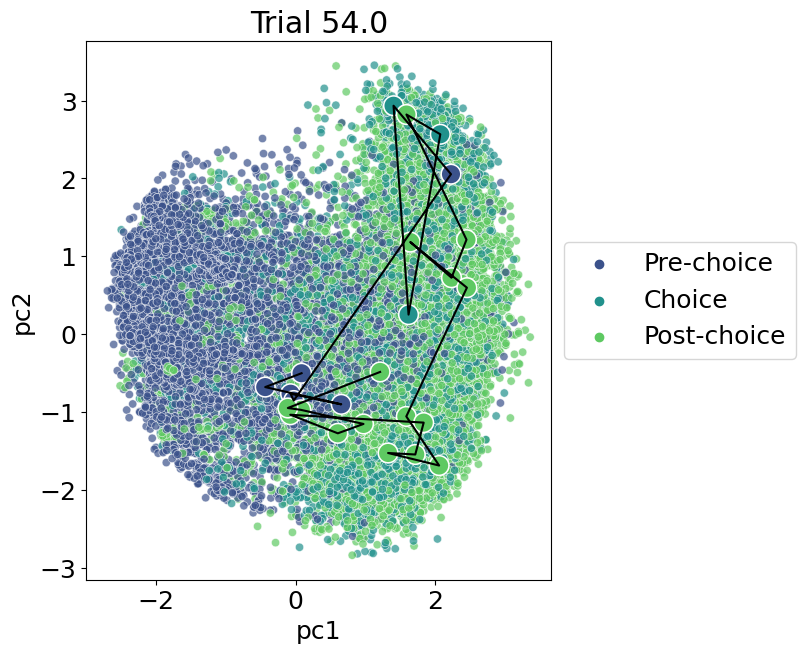

...

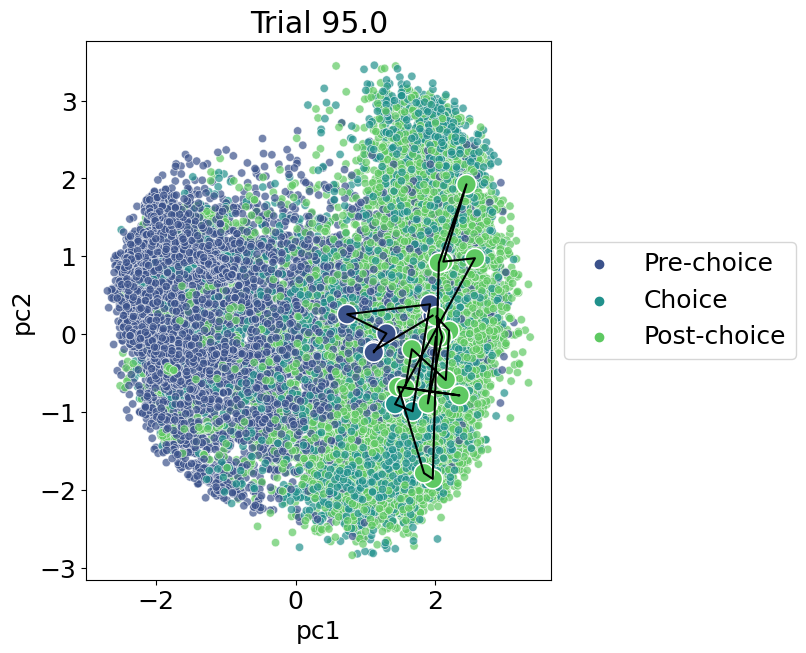

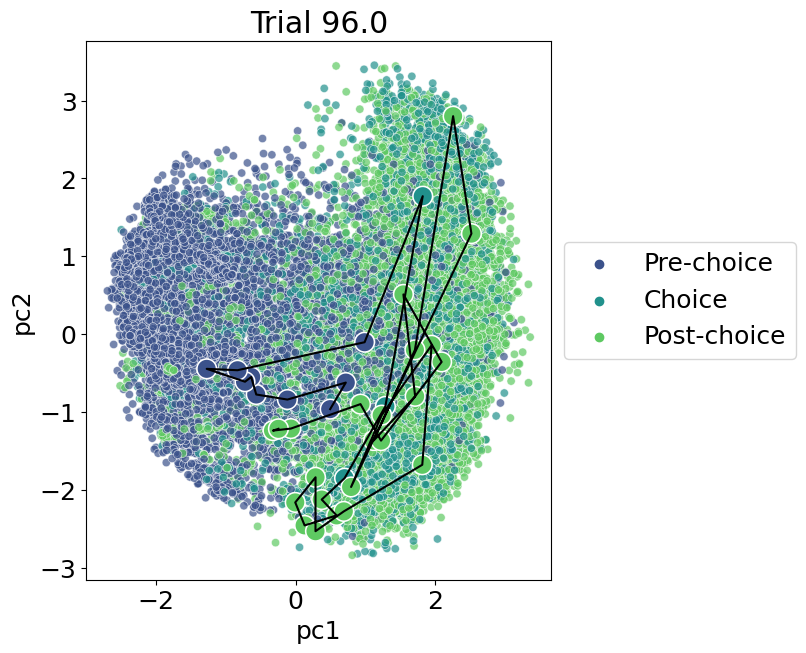

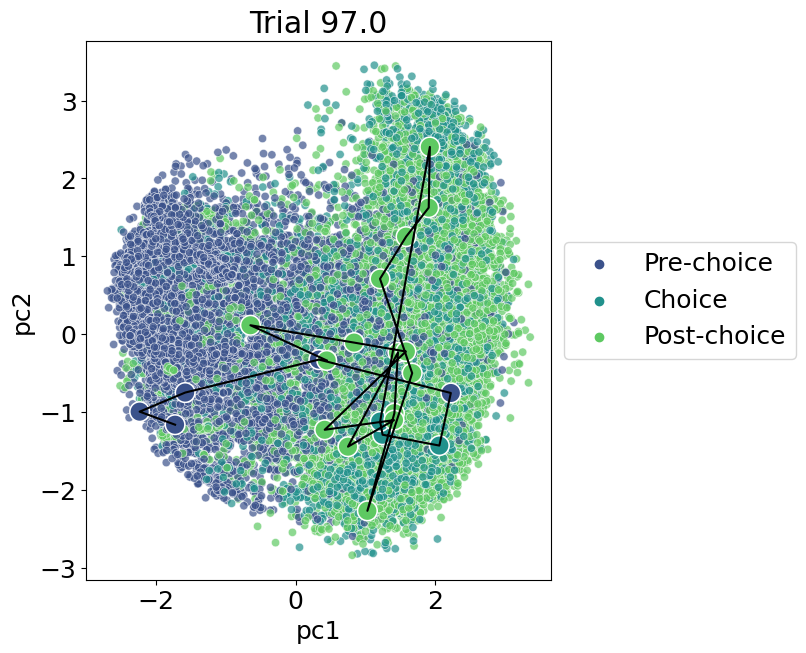

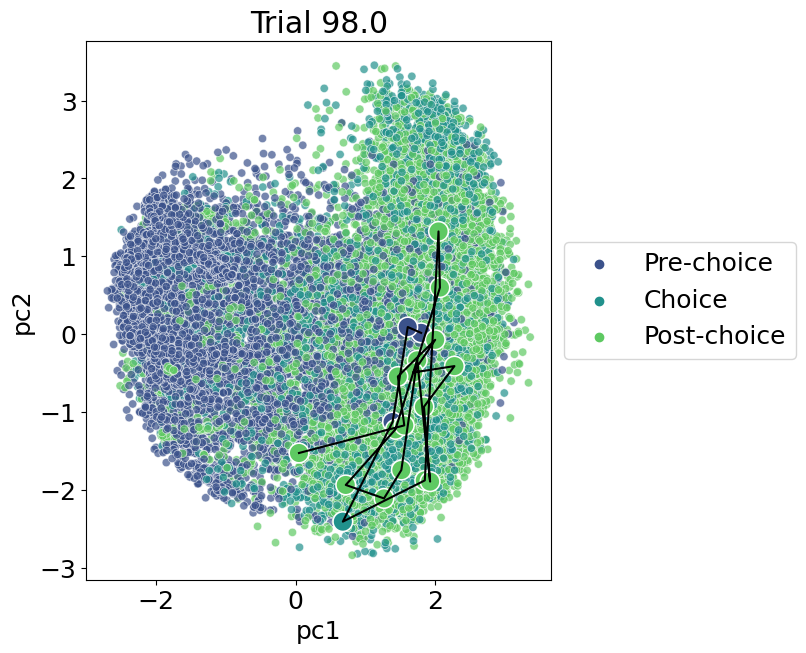

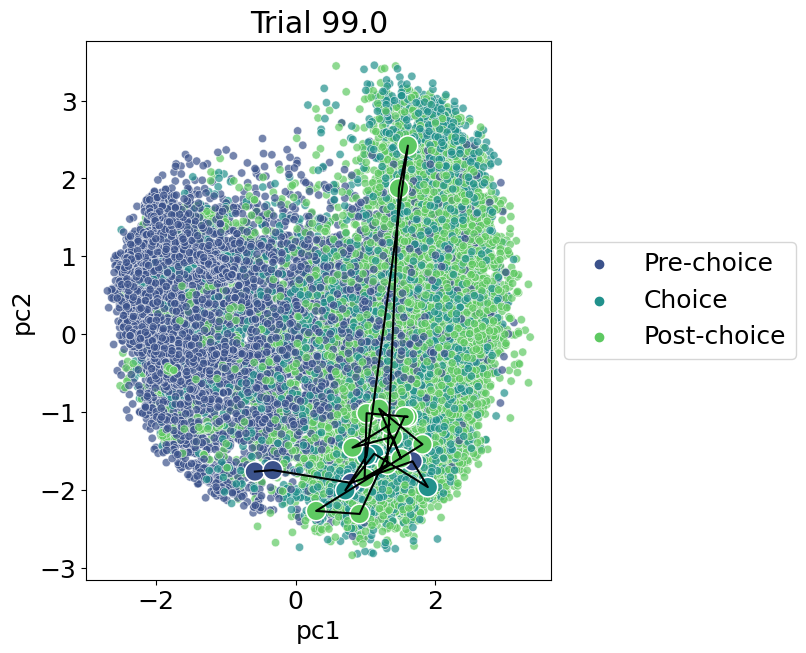

In [33]:
trials = augmented['Trial'].unique()
for t, trial in enumerate(trials[50:100]):
    trial_data_pc1 = augmented.loc[augmented['Trial']==trial, 'pc1']
    trial_data_pc2 = augmented.loc[augmented['Trial']==trial, 'pc2']
    use_data = augmented.loc[augmented['Trial']==trial]
    
    fig, axs = plt.subplots(figsize=[6, 7])
    sns.scatterplot(x='pc1', y='pc2', data=augmented, alpha=0.7, hue='broader_label', palette='viridis')
    sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=1, hue='broader_label', palette='viridis', s=200, legend=None)
    plt.plot(trial_data_pc1, trial_data_pc2, color='black')
    plt.legend(loc='upper left', bbox_to_anchor=(1, 0.65))
    plt.title('Trial ' + str(trial))
    plt.show()


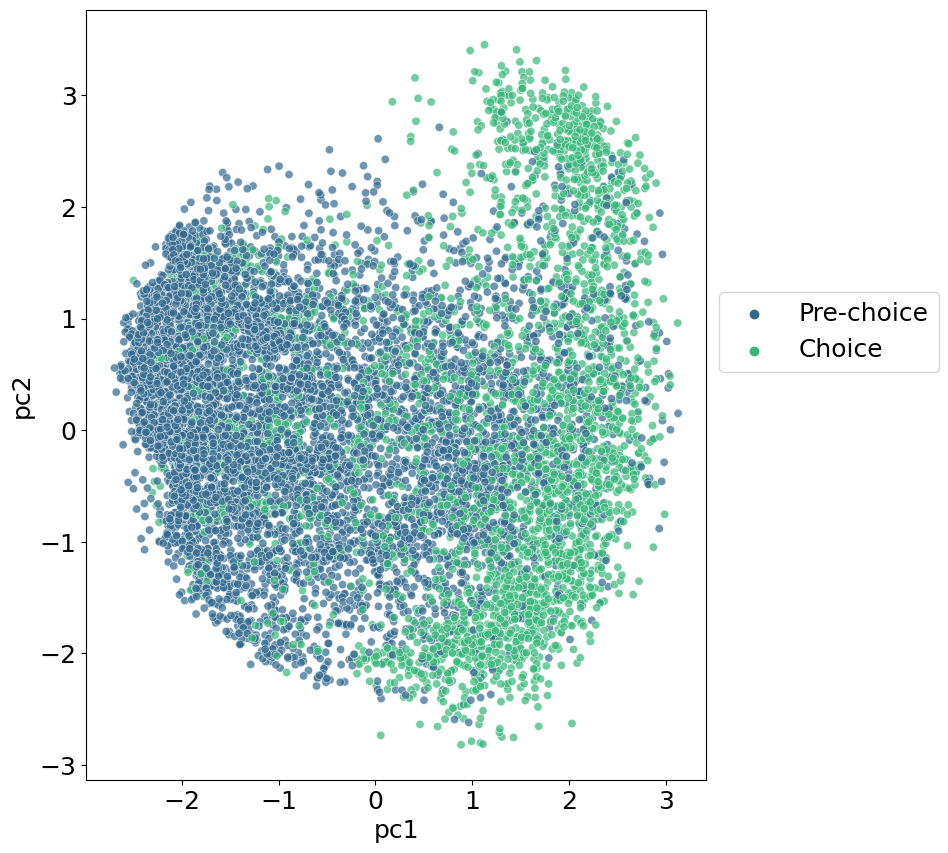

In [29]:
pair = ['Pre-choice', 'Choice']
#pair = ['Choice']
fig, axs = plt.subplots(figsize=[8, 10])
use_data = augmented.loc[augmented['broader_label'].isin(pair)]
sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.7, hue='broader_label', palette='viridis')
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.65))


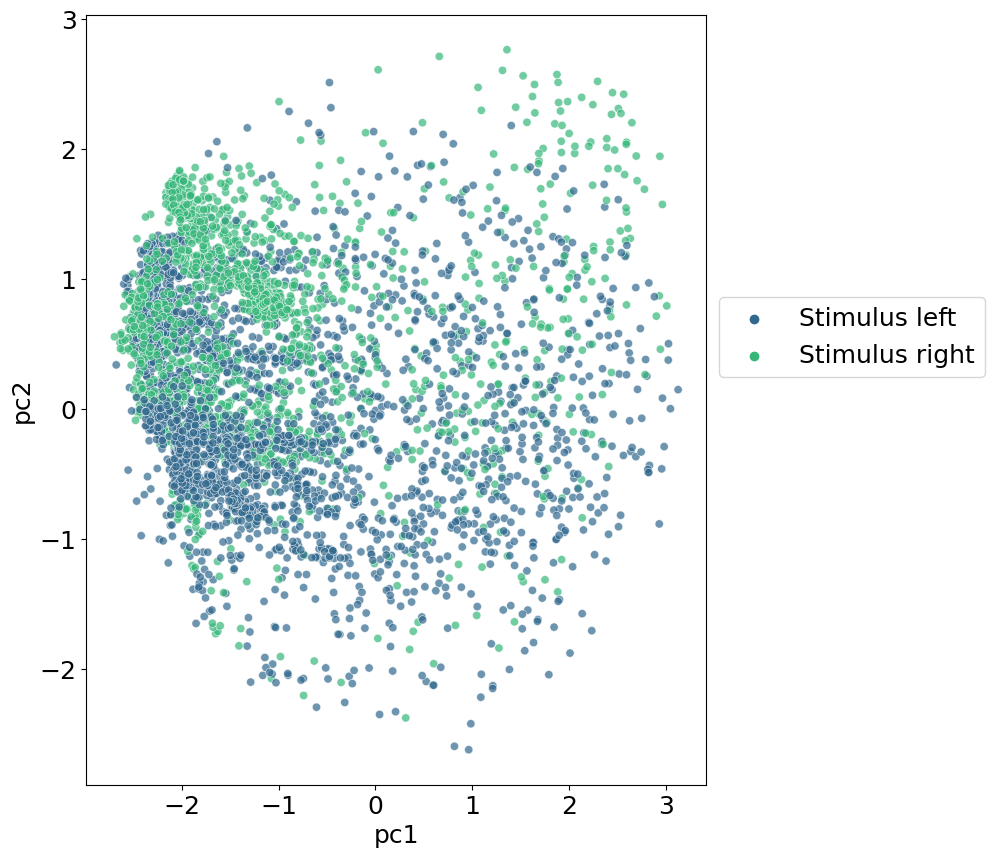

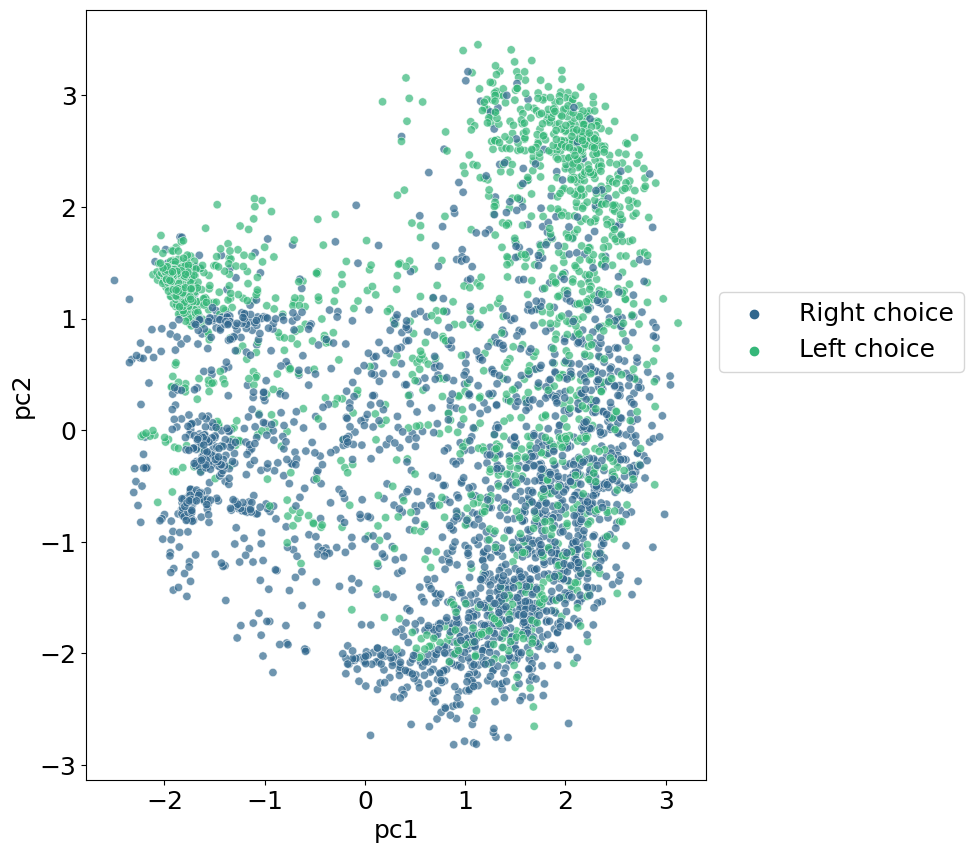

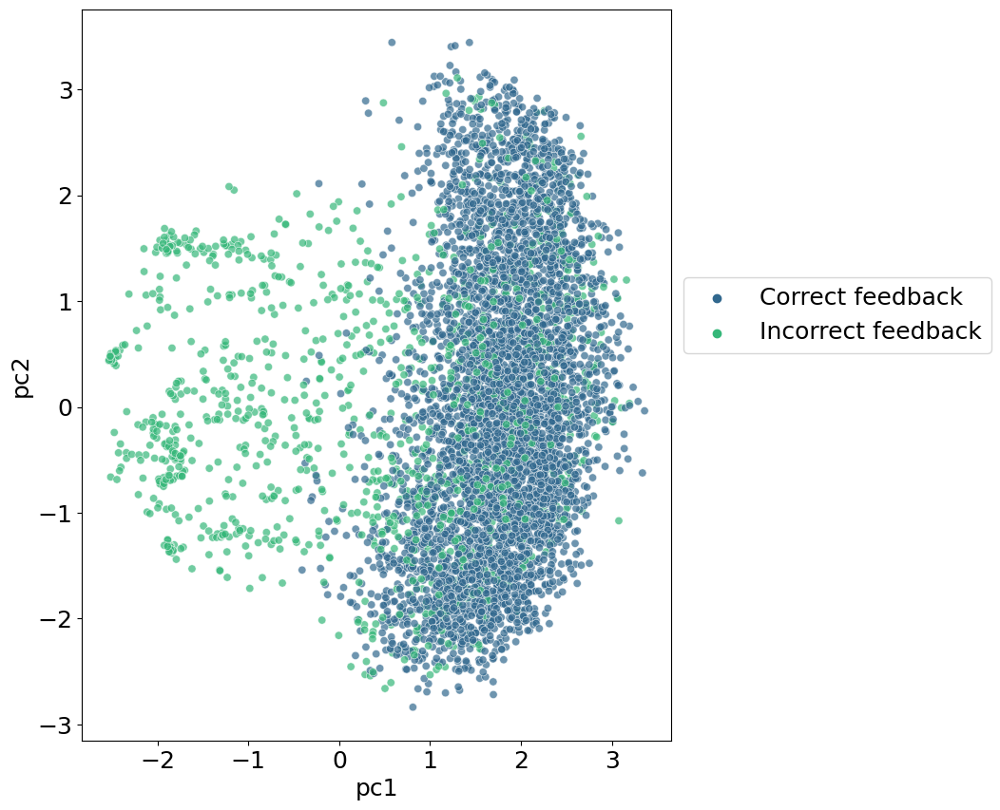

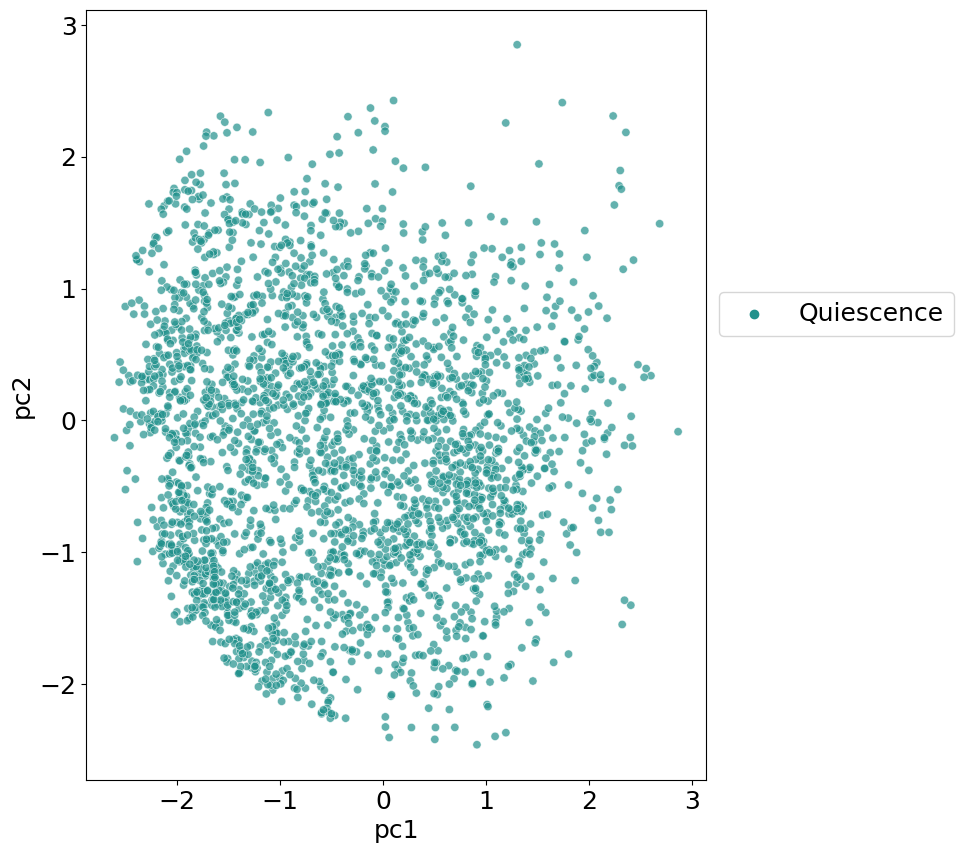

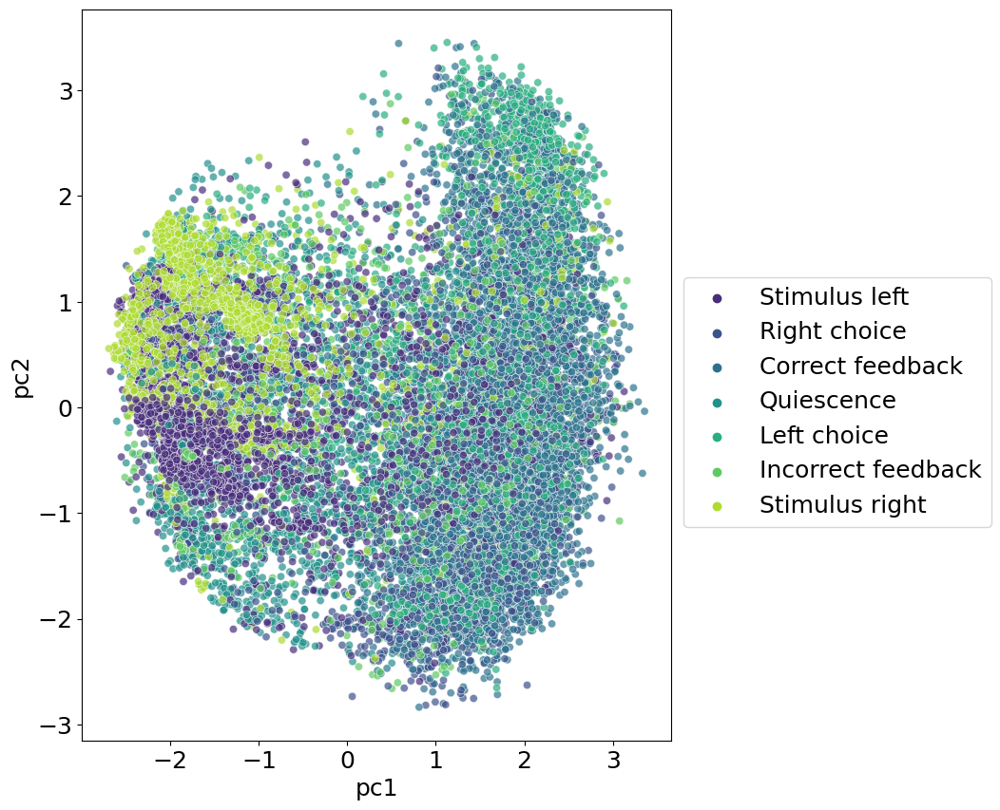

In [31]:
pairs = [['Stimulus right', 'Stimulus left'], ['Right choice', 'Left choice'], 
         ['Correct feedback', 'Incorrect feedback'], ['Quiescence', 'ITI'], 
         ['Stimulus left', 'Right choice', 'Correct feedback', 'ITI',
       'Quiescence', 'Left choice', 'Incorrect feedback',
       'Stimulus right']]

for pair in pairs:
    fig, axs = plt.subplots(figsize=[8, 10])
    use_data = augmented.loc[augmented['label'].isin(pair)]
    sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.7, hue='label', palette='viridis')
    plt.legend(loc='upper left', bbox_to_anchor=(1, 0.65))


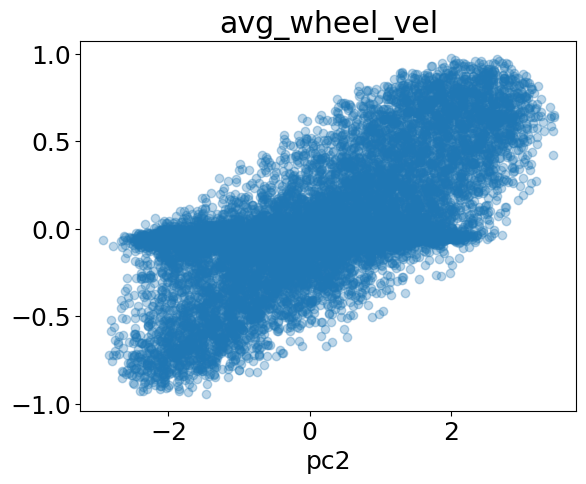

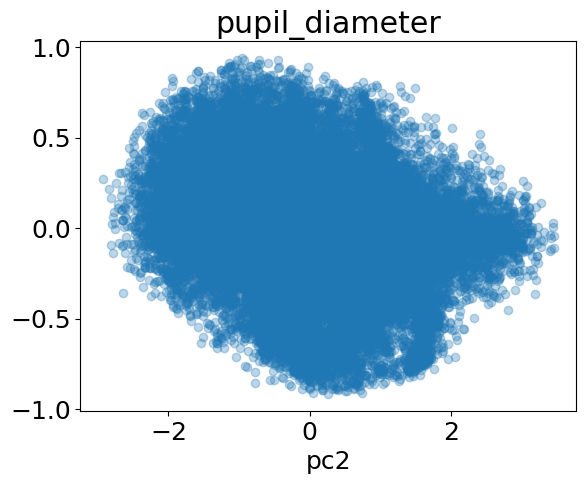

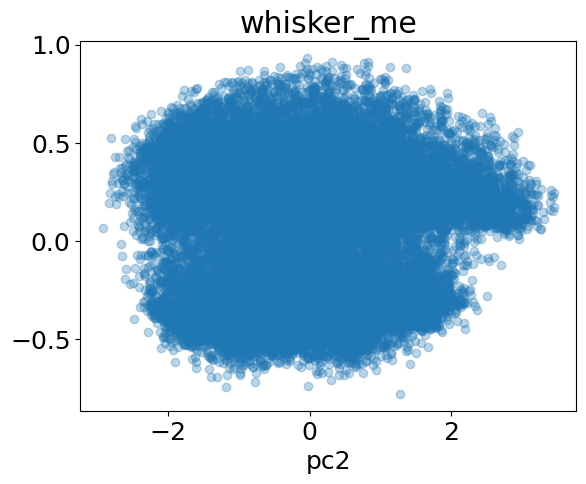

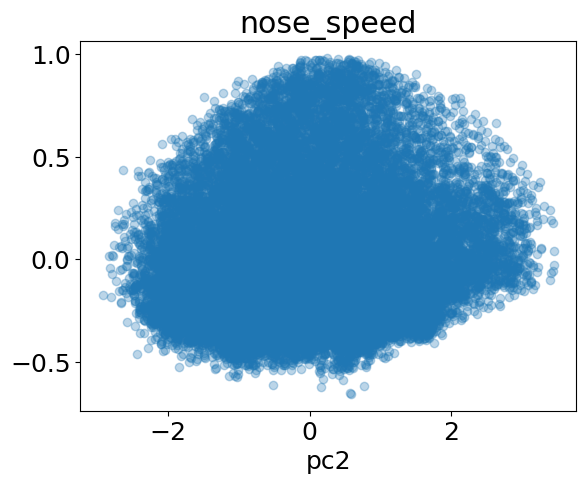

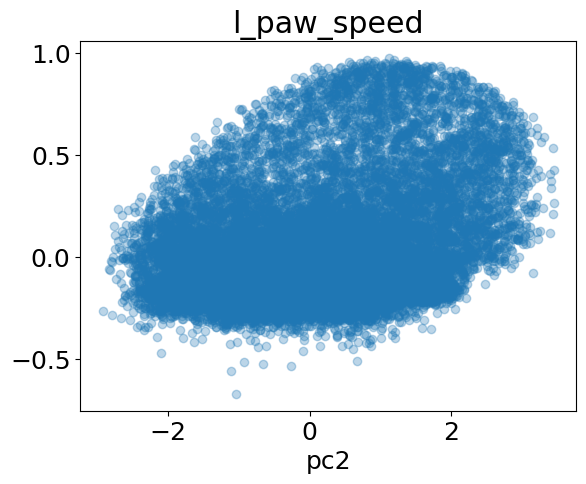

...

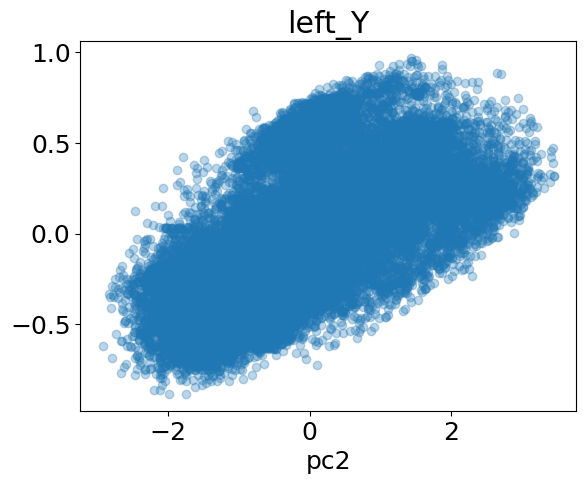

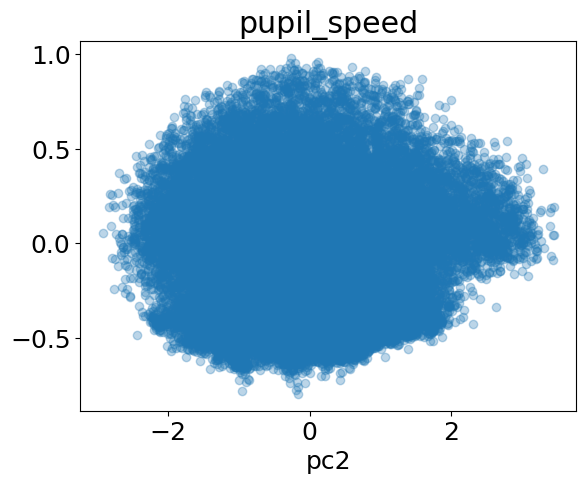

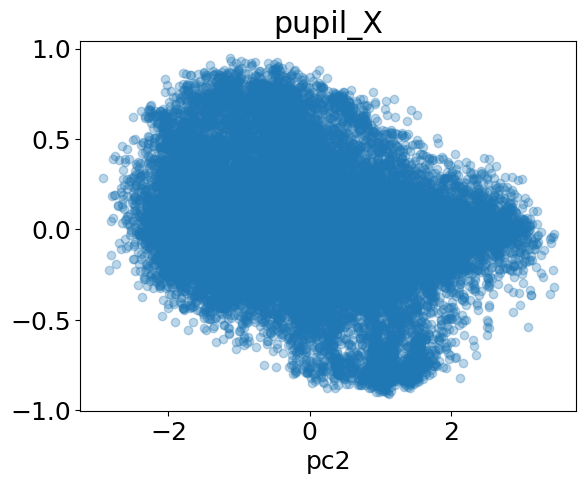

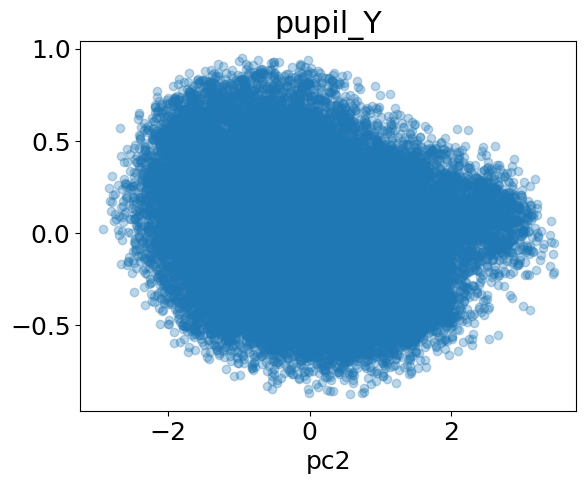

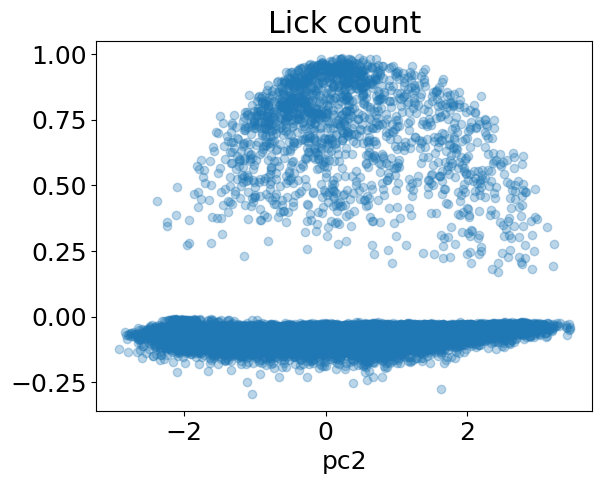

In [143]:
pc = 'pc2'
for v, var in enumerate(var_names):
    plt.scatter(np.array(augmented_data[pc]), X[:, v], alpha=0.3)
    plt.xlabel(pc)
    plt.title(var)
    plt.show()